<a href="https://colab.research.google.com/github/fareehanezam/GNCIPL_Projects/blob/main/GNCIPL_Project1_Disease_Diagnosis_Accuracy_Dataset.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

* **Project Title:** Disease Diagnosis Accuracy Dataset
* **Domain:**Medical Science
* **Domain Description:** Evaluate how accurate various diagnostic tests are.
* **Sample Analysis Goals**: Confusion matrix, ROC curves, false positive rates
* **Sample Dataset Source:** UCI Machine Learning Repository

## Data Loading & Initial Exploration

 Using the Breast Cancer Wisconsin (Diagnostic) dataset as it is a common and suitable dataset for classification tasks in disease diagnosis.



In [4]:
import pandas as pd
import numpy as np
import sklearn
import matplotlib.pyplot as plt
import seaborn as sns
import requests

# Dataset details
dataset_url = "https://archive.ics.uci.edu/ml/machine-learning-databases/breast-cancer-wisconsin/wdbc.data"
names_url = "https://archive.ics.uci.edu/ml/machine-learning-databases/breast-cancer-wisconsin/wdbc.names"

# Download the data
# Disable SSL verification as a workaround for the certificate error
data_response = requests.get(dataset_url, verify=False)
with open("wdbc.data", "wb") as f:
    f.write(data_response.content)

# Downloading the names file
# Disable SSL verification as a workaround for the certificate error
names_response = requests.get(names_url, verify=False)
with open("wdbc.names", "wb") as f:
    f.write(names_response.content)

# Loading the dataset
# The .names file indicates the columns are: ID, Diagnosis, and 30 real-valued features
column_names = ["ID", "Diagnosis"] + [f"feature_{i}" for i in range(30)]
df = pd.read_csv("wdbc.data", names=column_names)

# Displaying the first few rows and information about the dataset
display(df.head())
display(df.info())

/usr/local/lib/python3.12/dist-packages/urllib3/connectionpool.py:1097: InsecureRequestWarning: Unverified HTTPS request is being made to host 'archive.ics.uci.edu'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/latest/advanced-usage.html#tls-warnings
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/urllib3/connectionpool.py:1097: InsecureRequestWarning: Unverified HTTPS request is being made to host 'archive.ics.uci.edu'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/latest/advanced-usage.html#tls-warnings
  warnings.warn(


,ID,Diagnosis,feature_0,feature_1,feature_2,feature_3,feature_4,feature_5,feature_6,feature_7,...,feature_20,feature_21,feature_22,feature_23,feature_24,feature_25,feature_26,feature_27,feature_28,feature_29
0,842302,M,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.3001,0.14710,...,25.38,17.33,184.60,2019.0,0.1622,0.6656,0.7119,0.2654,0.4601,0.11890
1,842517,M,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.0869,0.07017,...,24.99,23.41,158.80,1956.0,0.1238,0.1866,0.2416,0.1860,0.2750,0.08902
2,84300903,M,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.1974,0.12790,...,23.57,25.53,152.50,1709.0,0.1444,0.4245,0.4504,0.2430,0.3613,0.08758
3,84348301,M,11.42,20.38,77.58,386.1,0.14250,0.28390,0.2414,0.10520,...,14.91,26.50,98.87,567.7,0.2098,0.8663,0.6869,0.2575,0.6638,0.17300
4,84358402,M,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.1980,0.10430,...,22.54,16.67,152.20,1575.0,0.1374,0.2050,0.4000,0.1625,0.2364,0.07678


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 569 entries, 0 to 568
Data columns (total 32 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   ID          569 non-null    int64  
 1   Diagnosis   569 non-null    object 
 2   feature_0   569 non-null    float64
 3   feature_1   569 non-null    float64
 4   feature_2   569 non-null    float64
 5   feature_3   569 non-null    float64
 6   feature_4   569 non-null    float64
 7   feature_5   569 non-null    float64
 8   feature_6   569 non-null    float64
 9   feature_7   569 non-null    float64
 10  feature_8   569 non-null    float64
 11  feature_9   569 non-null    float64
 12  feature_10  569 non-null    float64
 13  feature_11  569 non-null    float64
 14  feature_12  569 non-null    float64
 15  feature_13  569 non-null    float64
 16  feature_14  569 non-null    float64
 17  feature_15  569 non-null    float64
 18  feature_16  569 non-null    float64
 19  feature_17  569 non-null    f

None

In [5]:
# Reading and displaying the content of the wdbc.names file
with open("wdbc.names", "r") as f:
    names_content = f.read()

print(names_content)

1. Title: Wisconsin Diagnostic Breast Cancer (WDBC)

2. Source Information

a) Creators: 

	Dr. William H. Wolberg, General Surgery Dept., University of
	Wisconsin,  Clinical Sciences Center, Madison, WI 53792
	wolberg@eagle.surgery.wisc.edu

	W. Nick Street, Computer Sciences Dept., University of
	Wisconsin, 1210 West Dayton St., Madison, WI 53706
	street@cs.wisc.edu  608-262-6619

	Olvi L. Mangasarian, Computer Sciences Dept., University of
	Wisconsin, 1210 West Dayton St., Madison, WI 53706
	olvi@cs.wisc.edu 

b) Donor: Nick Street

c) Date: November 1995

3. Past Usage:

first usage:

	W.N. Street, W.H. Wolberg and O.L. Mangasarian 
	Nuclear feature extraction for breast tumor diagnosis.
	IS&T/SPIE 1993 International Symposium on Electronic Imaging: Science
	and Technology, volume 1905, pages 861-870, San Jose, CA, 1993.

OR literature:

	O.L. Mangasarian, W.N. Street and W.H. Wolberg. 
	Breast cancer diagnosis and prognosis via linear programming. 
	Operations Research, 43(4), pag

## EDA

 Performing initial data exploration to understand the structure, features, and target variable(s), and check for missing values, data types, and potential inconsistencies.


In [6]:
from sklearn.preprocessing import LabelEncoder

# Converting the 'Diagnosis' column to a numerical representation
le = LabelEncoder()
df['Diagnosis'] = le.fit_transform(df['Diagnosis'])

# Initial data exploration
display(df.head())
df.info()
display(df.describe())
display(df['Diagnosis'].value_counts())

,ID,Diagnosis,feature_0,feature_1,feature_2,feature_3,feature_4,feature_5,feature_6,feature_7,...,feature_20,feature_21,feature_22,feature_23,feature_24,feature_25,feature_26,feature_27,feature_28,feature_29
0,842302,1,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.3001,0.14710,...,25.38,17.33,184.60,2019.0,0.1622,0.6656,0.7119,0.2654,0.4601,0.11890
1,842517,1,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.0869,0.07017,...,24.99,23.41,158.80,1956.0,0.1238,0.1866,0.2416,0.1860,0.2750,0.08902
2,84300903,1,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.1974,0.12790,...,23.57,25.53,152.50,1709.0,0.1444,0.4245,0.4504,0.2430,0.3613,0.08758
3,84348301,1,11.42,20.38,77.58,386.1,0.14250,0.28390,0.2414,0.10520,...,14.91,26.50,98.87,567.7,0.2098,0.8663,0.6869,0.2575,0.6638,0.17300
4,84358402,1,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.1980,0.10430,...,22.54,16.67,152.20,1575.0,0.1374,0.2050,0.4000,0.1625,0.2364,0.07678


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 569 entries, 0 to 568
Data columns (total 32 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   ID          569 non-null    int64  
 1   Diagnosis   569 non-null    int64  
 2   feature_0   569 non-null    float64
 3   feature_1   569 non-null    float64
 4   feature_2   569 non-null    float64
 5   feature_3   569 non-null    float64
 6   feature_4   569 non-null    float64
 7   feature_5   569 non-null    float64
 8   feature_6   569 non-null    float64
 9   feature_7   569 non-null    float64
 10  feature_8   569 non-null    float64
 11  feature_9   569 non-null    float64
 12  feature_10  569 non-null    float64
 13  feature_11  569 non-null    float64
 14  feature_12  569 non-null    float64
 15  feature_13  569 non-null    float64
 16  feature_14  569 non-null    float64
 17  feature_15  569 non-null    float64
 18  feature_16  569 non-null    float64
 19  feature_17  569 non-null    f

,ID,Diagnosis,feature_0,feature_1,feature_2,feature_3,feature_4,feature_5,feature_6,feature_7,...,feature_20,feature_21,feature_22,feature_23,feature_24,feature_25,feature_26,feature_27,feature_28,feature_29
count,5.690000e+02,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,...,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000
mean,3.037183e+07,0.372583,14.127292,19.289649,91.969033,654.889104,0.096360,0.104341,0.088799,0.048919,...,16.269190,25.677223,107.261213,880.583128,0.132369,0.254265,0.272188,0.114606,0.290076,0.083946
std,1.250206e+08,0.483918,3.524049,4.301036,24.298981,351.914129,0.014064,0.052813,0.079720,0.038803,...,4.833242,6.146258,33.602542,569.356993,0.022832,0.157336,0.208624,0.065732,0.061867,0.018061
min,8.670000e+03,0.000000,6.981000,9.710000,43.790000,143.500000,0.052630,0.019380,0.000000,0.000000,...,7.930000,12.020000,50.410000,185.200000,0.071170,0.027290,0.000000,0.000000,0.156500,0.055040
25%,8.692180e+05,0.000000,11.700000,16.170000,75.170000,420.300000,0.086370,0.064920,0.029560,0.020310,...,13.010000,21.080000,84.110000,515.300000,0.116600,0.147200,0.114500,0.064930,0.250400,0.071460
50%,9.060240e+05,0.000000,13.370000,18.840000,86.240000,551.100000,0.095870,0.092630,0.061540,0.033500,...,14.970000,25.410000,97.660000,686.500000,0.131300,0.211900,0.226700,0.099930,0.282200,0.080040
75%,8.813129e+06,1.000000,15.780000,21.800000,104.100000,782.700000,0.105300,0.130400,0.130700,0.074000,...,18.790000,29.720000,125.400000,1084.000000,0.146000,0.339100,0.382900,0.161400,0.317900,0.092080
max,9.113205e+08,1.000000,28.110000,39.280000,188.500000,2501.000000,0.163400,0.345400,0.426800,0.201200,...,36.040000,49.540000,251.200000,4254.000000,0.222600,1.058000,1.252000,0.291000,0.663800,0.207500


,count
Diagnosis,
0,357
1,212


 * The df.head() output confirms this, showing 0s and 1s in the
 'Diagnosis' column.
 * The df.info() output shows that the 'Diagnosis' column is now of integer type (int64).
 * It also indicates that the DataFrame has 569 entries and 32 columns (although the 'ID' column might be dropped later, it's present at this stage). Importantly, the "Non-Null Count" for all columns is 569, which means there are no missing values in the dataset.
 * df.info() and df.describe() confirms that most of the features are numerical (float64), which is suitable for most machine learning models. The 'ID' is int64.
 * The df.describe() output provides summary statistics (mean, std, min, max, quartiles) for all the numerical features. This gives a quick overview of the range and distribution of values for each feature.
 * The df['Diagnosis'].value_counts() output shows the distribution of the target variable: there are 357 cases labeled as 0 (Benign) and 212 cases labeled as 1 (Malignant). This indicates that the dataset is somewhat imbalanced, with more benign cases than malignant cases. This is an important finding to consider when choosing models and evaluation metrics.

In [7]:
# Outlier Detection using IQR
# Calculate Q1, Q3, and IQR for each feature
Q1 = df.quantile(0.25)
Q3 = df.quantile(0.75)
IQR = Q3 - Q1

# Defining outlier bounds
lower_bound = Q1 - 1.5 * IQR
upper_bound = Q3 + 1.5 * IQR

# Identifying outliers
outliers = ((df < lower_bound) | (df > upper_bound)).any(axis=1)

print("Number of rows with at least one outlier (based on IQR):")
display(outliers.sum())

Number of rows with at least one outlier (based on IQR):


np.int64(223)

The output np.int64(223) tells us that 223 out of the 569 rows in dataset have at least one feature value that is considered an outlier according to the IQR method (i.e., the value falls below the lower bound or above the upper bound calculated based on the first and third quartiles).

This is a significant number of rows (approximately 39% of the dataset). This finding from the outlier detection suggests that there are indeed a notable number of data points with extreme values in one or more features.

In [8]:
# Analyzing feature distributions (Skewness and Kurtosis)
print("\nSkewness of features:")
# Dropping the 'ID' column from skewness/kurtosis calculation as it's not a feature
display(df.drop(['ID'], axis=1).skew())

print("\nKurtosis of features:")
# Dropping the 'ID' column from skewness/kurtosis calculation as it's not a feature
display(df.drop(['ID'], axis=1).kurtosis())


Skewness of features:


,0
Diagnosis,0.528461
feature_0,0.942380
feature_1,0.650450
feature_2,0.990650
feature_3,1.645732
feature_4,0.456324
feature_5,1.190123
feature_6,1.401180
feature_7,1.171180
feature_8,0.725609



Kurtosis of features:


,0
Diagnosis,-1.726811
feature_0,0.845522
feature_1,0.758319
feature_2,0.972214
feature_3,3.652303
feature_4,0.855975
feature_5,1.650130
feature_6,1.998638
feature_7,1.066556
feature_8,1.287933


**Skewness:**
* The skewness values indicate the asymmetry of each feature's distribution.
* A skewness of 0 means the distribution is perfectly symmetrical (like a normal distribution).
* Positive skewness means the tail of the distribution is longer on the right side (more high values).
* Negative skewness means the tail is longer on the left side (more low values).
* Many features in dataset show moderate to high positive skewness (e.g., feature_3, feature_5, feature_6, feature_10, feature_13, feature_19, feature_23, feature_25, feature_28, feature_29). This means their distributions are not symmetrical and have a longer tail towards higher values. The Diagnosis column also has a positive skewness (around 0.53), reflecting the class imbalance.

**Kurtosis:**
* The kurtosis values indicate the "tailedness" and peakedness of the distribution compared to a normal distribution.
* Positive kurtosis (Leptokurtic) means the distribution has heavier tails (more outliers) and a sharper peak than a normal distribution.
* Negative kurtosis (Platykurtic) means the distribution has lighter tails and a flatter peak than a normal distribution.
* Several features exhibit high positive kurtosis (e.g., feature_10, feature_12, feature_13, feature_16, feature_19, feature_23, feature_28, feature_29). This suggests that these features have more extreme values (outliers) or are more sharply peaked than a normal distribution.

 The skewness and kurtosis analysis reveals that many of your features have distributions that are significantly different from a normal distribution. The presence of high positive skewness and high positive kurtosis for several features indicates that these distributions are asymmetrical with a tendency towards extreme values. This insight is valuable for:


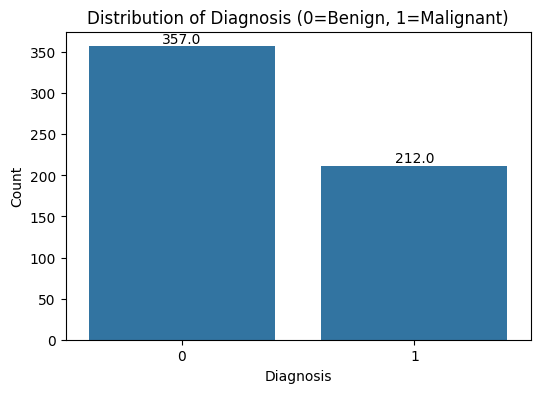

In [9]:
# Countplot of Diagnosis with absolute numbers
plt.figure(figsize=(6, 4))
ax = sns.countplot(x='Diagnosis', data=df)
plt.title('Distribution of Diagnosis (0=Benign, 1=Malignant)') # title
plt.xlabel('Diagnosis')
plt.ylabel('Count')
for p in ax.patches:
    ax.annotate(f'{p.get_height()}', (p.get_x() + p.get_width() / 2., p.get_height()),
                ha='center', va='center', xytext=(0, 5), textcoords='offset points')
plt.show()

The countplot visually represents the distribution of the target variable, showing the number of instances belonging to each diagnosis class.

* The bar labeled '0' (representing Benign cases) has an annotated count of 357.
* The bar labeled '1' (representing Malignant cases) has an annotated count of 212.

 The countplot clearly shows that the dataset is imbalanced, with a significantly higher number of instances classified as Benign (357) compared to Malignant (212). This confirms the observation made earlier from the value_counts() output.

This class imbalance is an important factor to keep in mind when building and evaluating your models. Some models might be biased towards the majority class (Benign), and evaluation metrics like accuracy alone might be misleading. Metrics like precision, recall (sensitivity), and F1-score, especially for the minority class (Malignant), become crucial for a proper assessment of model performance in such cases.

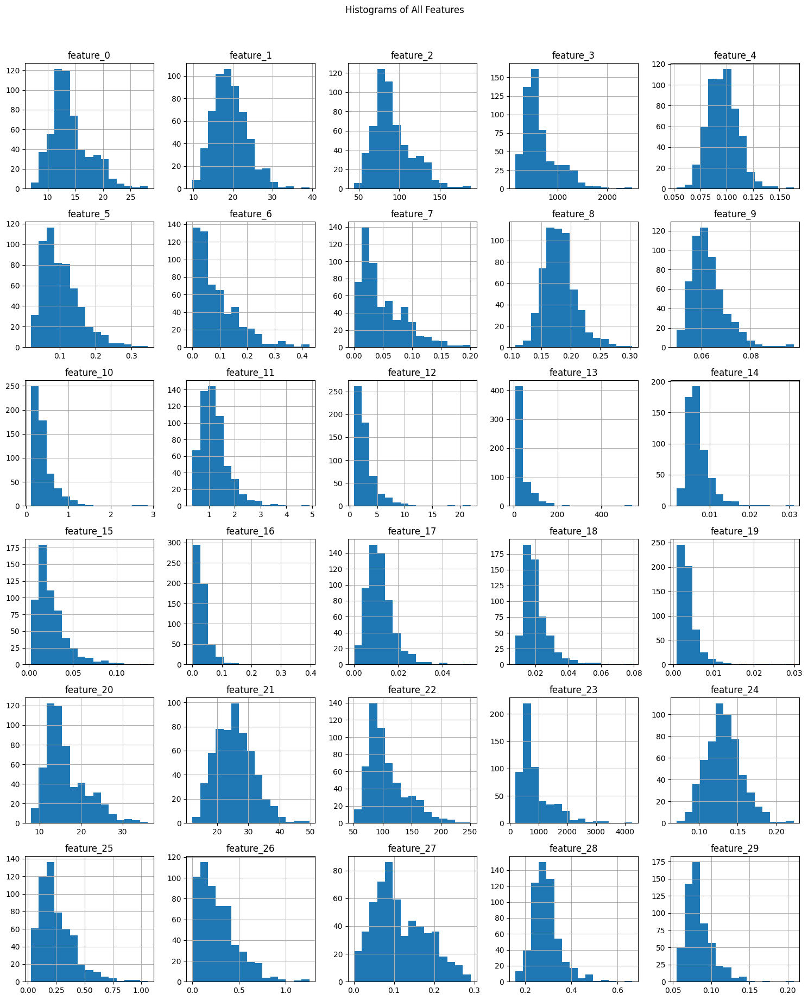

In [10]:
# Histograms of all Features
features_to_plot = df.columns[2:] # Select all columns from index 1 onwards (excluding Diagnosis)
n_features = len(features_to_plot)
n_cols = 5 # Number of columns in the subplot grid
n_rows = (n_features + n_cols - 1) // n_cols # Calculating number of rows needed

df[features_to_plot].hist(bins=15, figsize=(15, n_rows * 3), layout=(n_rows, n_cols))
plt.suptitle('Histograms of All Features', y=1.02)
plt.tight_layout()
plt.show()

* The histograms visually confirm the skewness observed in the numerical skewness values. Many features show a clear skew, predominantly positive skewness, where the tail of the distribution extends towards higher values. This is visible as the bars being concentrated on the left side with a longer tail to the right.
* While many features are skewed, a variety of distribution shapes can be seen. Some appear closer to a normal distribution (though likely still somewhat skewed), while others are clearly not normal.

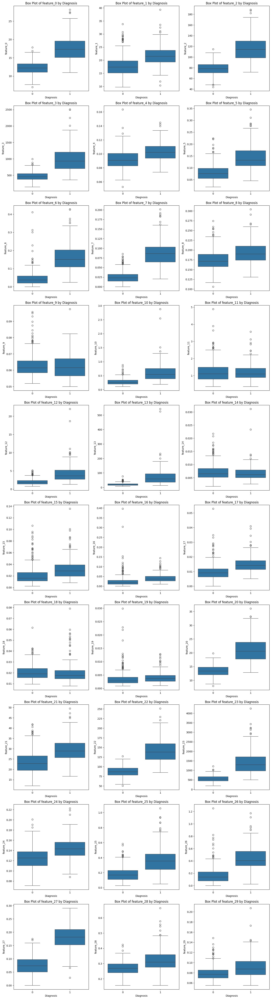

In [11]:
# Box Plots of Features by Diagnosis
features_for_boxplot = df.columns[2:]
plt.figure(figsize=(15, len(features_for_boxplot)*2))
for i, feature in enumerate(features_for_boxplot):
    plt.subplot(len(features_for_boxplot)//3 + 1, 3, i + 1) # Arranging plots in a grid
    sns.boxplot(x='Diagnosis', y=feature, data=df)
    plt.title(f'Box Plot of {feature} by Diagnosis')
plt.tight_layout()
plt.show()

* **Separation of Distributions:** Many features show clear differences in distribution between the Benign (0) and Malignant (1) groups. The boxes and whiskers for the two diagnosis categories are located at different value ranges for many features.
* **Discriminatory Power:** Features where the box plots for
Benign and Malignant cases are well-separated along the y-axis are strong indicators or discriminators of the diagnosis. Features with minimal overlap in their box plots are particularly valuable for classification.
* **Key Discriminatory Features:** Features like feature_0 (mean radius), feature_2 (mean perimeter), feature_3 (mean area), feature_20 (worst radius), feature_22 (worst perimeter), and feature_23 (worst area) stand out as showing particularly good separation between the two diagnosis groups. The median and quartiles for these features are significantly higher for malignant cases compared to benign cases.
* **Outlier Visualization:** The box plots also visually highlight the presence and distribution of outliers for each feature and within each diagnosis group. This complements the numerical outlier detection.

The box plots by diagnosis are very informative for understanding the discriminatory power of individual features. They visually confirm that many features have different distributions for Benign and Malignant cases and clearly identify features that are likely to be most important for building a classification model. They also provide a visual representation of the spread and outliers within each group.

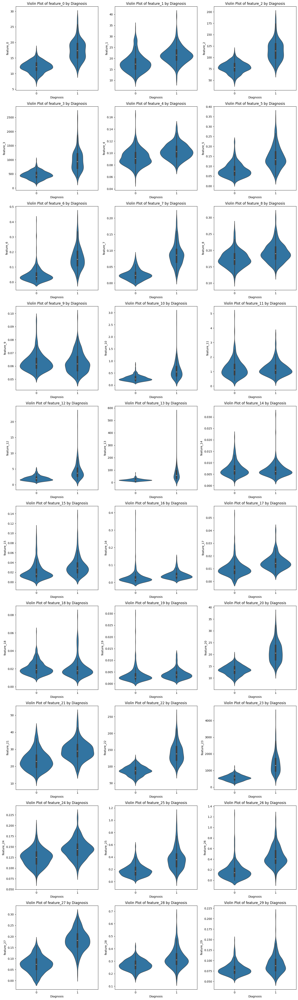

In [12]:
# Violin Plots of Features by Diagnosis
features_to_plot = df.columns[2:]
n_features = len(features_to_plot)
n_cols = 3 # Number of columns in the subplot grid
n_rows = (n_features + n_cols - 1) // n_cols # Calculating number of rows needed

plt.figure(figsize=(15, n_rows * 5)) # figure size based on number of rows
for i, feature in enumerate(features_to_plot):
    plt.subplot(n_rows, n_cols, i + 1)
    sns.violinplot(x='Diagnosis', y=feature, data=df)
    plt.title(f'Violin Plot of {feature} by Diagnosis')
plt.tight_layout()
plt.show()

* **Confirmation of Distribution Differences:** The violin plots visually confirm the differences in distributions between the Benign (0) and Malignant (1) groups that we saw in the box plots. The shapes and locations of the "violins" are clearly different for many features across the two diagnosis categories.
* **Insights into Distribution Shape:** The violin plots provide more detail about the density of the data at different values within each group compared to box plots. For most features, the distributions within both the Benign and Malignant groups appear unimodal. There isn't strong visual evidence of clear bimodal or multimodal distributions for many features. The primary difference in shape is often related to skewness, particularly positive skewness, as noted from the histograms and skewness values.
* **Discriminatory Power:** Features where the violins for Benign and Malignant cases are well-separated along the y-axis are strong indicators of the diagnosis. The width of the violin indicates the density of data points at that value.
* **Visualizing Outliers:** The box plots and violin plots clearly show the presence of outliers for many features in both diagnosis groups. The numerical outlier detection using IQR confirmed that a significant number of rows contain at least one outlier. Outliers tend to be more prevalent in the upper tail of the distributions, consistent with the positive skewness observed for many features. Some features exhibit a larger number or more extreme outliers than others.

 The violin plots offer a detailed visualization of the distribution of each feature for Benign and Malignant cases. In summary, while most features are unimodal, many exhibit positive skewness and the presence of outliers, particularly at higher values. The extent of skewness and outlier presence varies by feature and can differ slightly between the Benign and Malignant groups. Features related to mean and 'worst' measurements of radius, perimeter, and area are particularly strong discriminators, often showing greater skewness and more extreme outliers in the malignant cases.

In [13]:
# Pairwise scatter plots for a subset of features
# Adjusting height to make the plots larger
sns.pairplot(df.drop('ID', axis=1), vars=df.columns[2:], hue='Diagnosis', diag_kind='kde', height=2.5) # Increased height
plt.suptitle('Pairwise Scatter Plots of All Features by Diagnosis', y=1.02) # Corrected title
plt.show()

* **Relationships Between Features:**
  * Many pairs of features show a strong positive linear correlation. For example, features related to radius, perimeter, and area within the 'mean', 'error', and 'worst' groups are highly correlated (e.g., feature_0 vs feature_2, feature_0 vs feature_3, feature_20 vs feature_22, etc.). This is visually represented by the points clustering along a roughly straight line.
  * Some relationships don't appear perfectly linear. For example, the relationship between feature_2 (mean perimeter) and feature_3 (mean area) is inherently non-linear (area is related to the square of the perimeter). This is visible as a curved trend in the scatter plot for these features.
**Separation of Diagnosis Groups:** The scatter plots show how well pairs of features can separate the Benign (blue) and Malignant (orange) cases.
  * In many plots involving the highly discriminatory features (like those related to radius, perimeter, and area), you can see a clear separation between the blue and orange points. The points for the two diagnosis groups tend to occupy different regions in the scatter plot.
  * Some pairs of features show better separation than others. Pairs involving features like feature_0, feature_2, feature_3, feature_20, feature_22, and feature_23 are particularly effective at separating the classes.
**Diagonal KDE Plots:** The plots on the diagonal are Kernel Density Estimate (KDE) plots for each feature, separated by Diagnosis. These are essentially smoothed histograms and visually represent the distribution of each individual feature for the two diagnosis groups. This complements the histograms and reinforces the observations about modality and separation for individual features.

The pairwise scatter plots provide valuable insights into the relationships between features and the discriminatory power of feature pairs. They visually confirm strong correlations among groups of features and highlight features or pairs of features that are effective at separating Benign and Malignant cases. The non-linear relationships observed (like between perimeter and area) also reinforce the idea that feature engineering (like polynomial features) might be beneficial. The KDE plots on the diagonal offer a smoothed view of individual feature distributions by diagnosis.

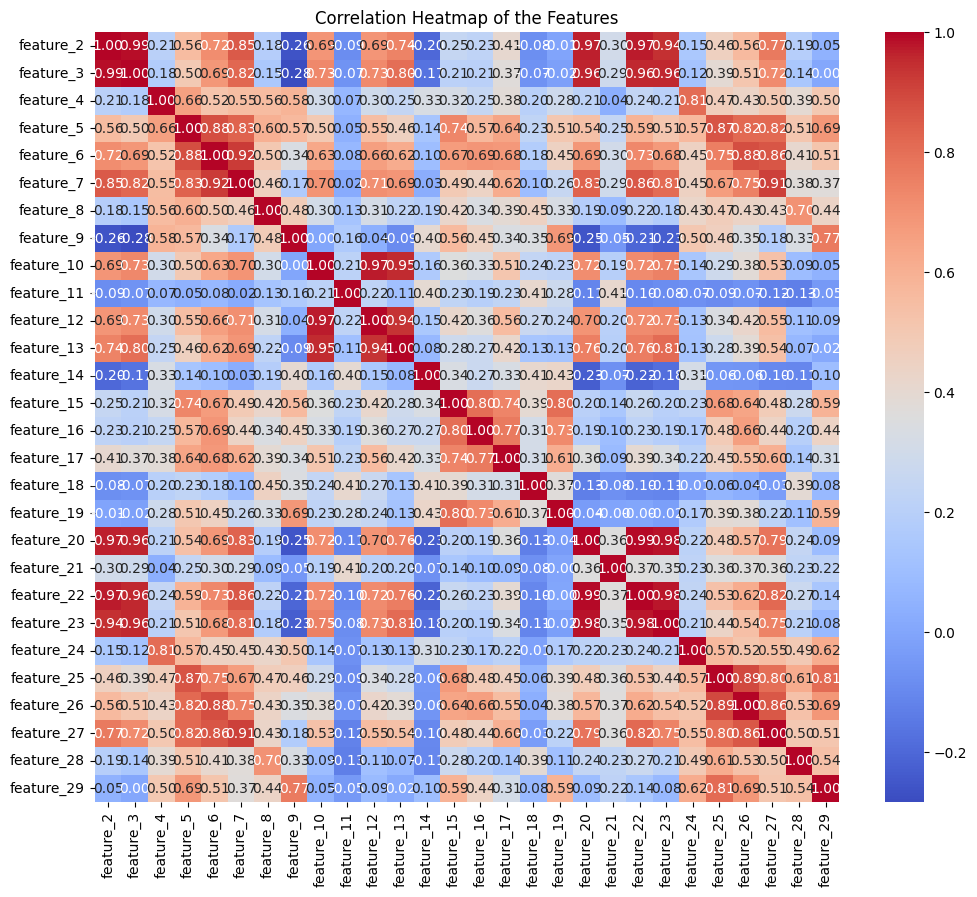

In [14]:
# Correlation Heatmap
correlation_matrix = df.drop(['ID', 'Diagnosis'], axis=1).corr()

# Calculating correlation matrix
correlation_matrix_df = df.drop(['ID', 'Diagnosis'], axis=1).corr()
plt.figure(figsize=(12, 10))
sns.heatmap(correlation_matrix_df.iloc[2:, 2:], annot=True, cmap='coolwarm', fmt=".2f") # Plotting a subset
plt.title('Correlation Heatmap of the Features')
plt.show()

The correlation heatmap visually represents the pairwise linear correlation coefficients between the selected features. The color intensity and the value in each cell indicate the strength and direction of the linear relationship between two features.

* **Strong Positive Correlations:** Strong positive correlations (values close to +1, often in red/dark red) among features within the same measurement category (mean, standard error, worst) is observed . For example:
Features related to mean measurements (e.g., feature_0 (radius), feature_1 (texture), feature_2 (perimeter), feature_3 (area)) are often highly correlated with each other.
Features related to worst measurements (e.g., feature_20 (worst radius), feature_21 (worst texture), feature_22 (worst perimeter), feature_23 (worst area)) are also typically highly correlated among themselves and often strongly correlated with their corresponding 'mean' features.
Features related to standard error measurements might show correlations, but often less strong than the 'mean' and 'worst' features.
* **Weak or Negative Correlations:** Values close to 0 indicate a weak linear relationship (often in white or light colors). Negative values (in blue/dark blue) indicate a negative linear correlation, where one feature increases as the other decreases. While less common among the geometric features, you might see some weaker or negative correlations between certain pairs.
* **Multicollinearity:** High correlations between features (multicollinearity) can be observed in areas with intense colors (red or blue). This means that some features provide similar information, and including all of them in a model might not add much value and could potentially cause issues for models sensitive to multicollinearity (like linear regression).

The correlation heatmap is excellent for identifying strong linear relationships and multicollinearity among your features. The high correlations within groups of features (like mean, error, worst) are expected given their definitions (e.g., perimeter and area are related to radius). Identifying these correlations is important for feature selection, as removing highly correlated features can be considered or using dimensionality reduction techniques like PCA (which we explored) to address multicollinearity. It also provides context for the relationships observed in the pairwise scatter plots

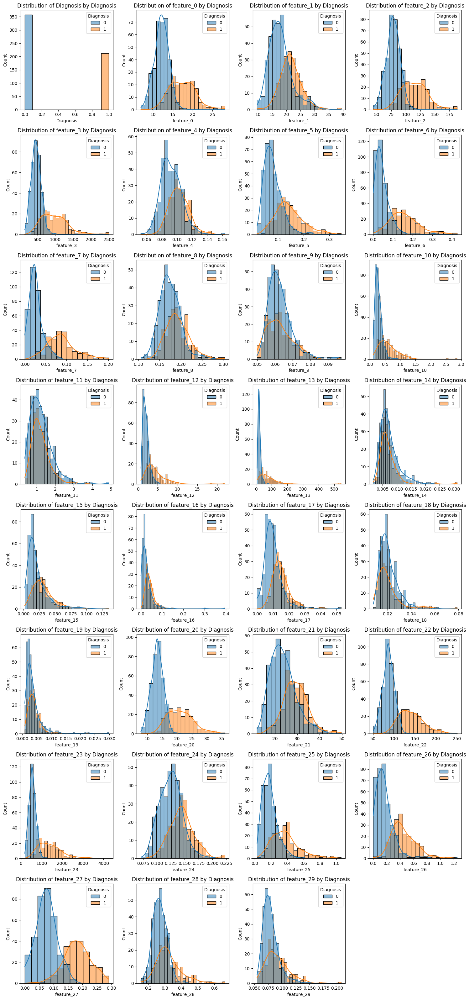

In [15]:
# Distribution plots for all the features by Diagnosis
features_to_plot = df.columns[1:]
n_features = len(features_to_plot)
n_cols = 4 # Number of columns in the subplot grid (adjust as needed)
n_rows = (n_features + n_cols - 1) // n_cols # Calculating number of rows needed

plt.figure(figsize=(15, n_rows * 4)) #figure size based on number of rows and desired plot size
for i, feature in enumerate(features_to_plot):
    plt.subplot(n_rows, n_cols, i + 1)
    sns.histplot(data=df, x=feature, kde=True, hue='Diagnosis')
    plt.title(f'Distribution of {feature} by Diagnosis')
    plt.xlabel(feature) # Setting xlabel to the feature name
plt.tight_layout()
plt.show()

These plots are very informative as they show the distribution of each feature broken down by the target variable. The overlapping or separation of the blue (Benign) and orange (Malignant) distributions for each feature is key.

* **Discriminatory Power:** Features where the histograms/KDE curves for Benign and Malignant cases are clearly separated with minimal overlap are strong discriminators. The less overlap, the better the feature is at distinguishing between the two classes.
* **Distribution Shapes by Diagnosis:** The shape of the distribution for each feature within each diagnosis group can be observed. This reinforces the findings from the individual histograms and the skewness/kurtosis analysis, showing if the distributions are skewed or appear unimodal.
* **Location of Distributions:** For discriminatory features, the distributions for the two diagnosis groups will be centered around different values. For example, for features like feature_0, feature_2, and feature_3, the distribution for Malignant cases is shifted towards higher values compared to the distribution for Benign cases.
* **Overlap and Ambiguity:** Features where the histograms for the two groups largely overlap are less useful as single predictors, as their values are similar for both Benign and Malignant cases.

The distribution plots by diagnosis are a powerful visualization for understanding the relationship between each individual feature and the target variable. They clearly highlight which features are most effective at separating the two diagnosis classes based on the shape and location of their distributions. Features with well-separated distributions are strong candidates for inclusion in your predictive model. They also provide visual confirmation of the distribution characteristics (like skewness and modality) within each diagnosis group.

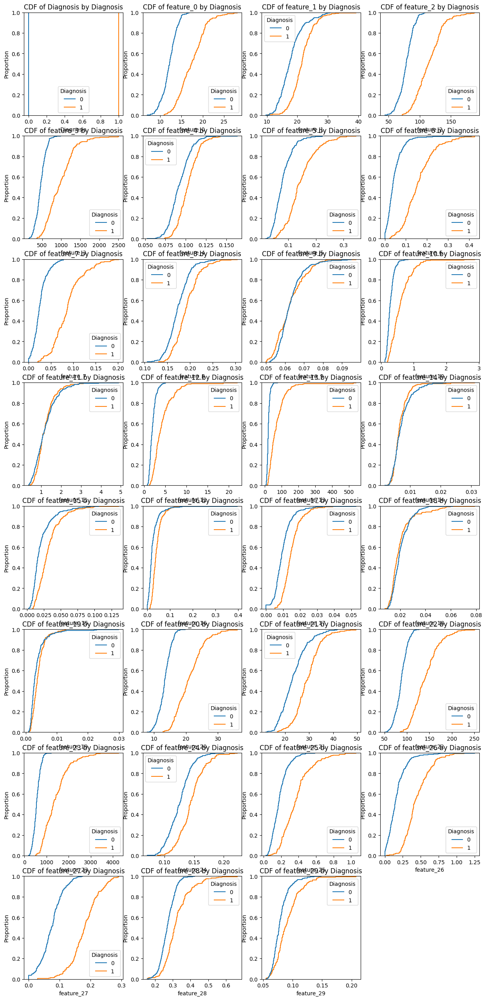

In [16]:
# Cumulative Distribution Function (CDF) plots
features_to_plot = df.columns[1:]
n_features = len(features_to_plot)
n_cols = 4 # Number of columns in the subplot grid (adjust as needed)
n_rows = (n_features + n_cols - 1) // n_cols # Calculating number of rows needed

plt.figure(figsize=(15, n_rows * 4)) # figure size based on number of rows and desired plot size
for i, feature in enumerate(features_to_plot):
    plt.subplot(n_rows, n_cols, i + 1)
    sns.ecdfplot(data=df, x=feature, hue='Diagnosis')
    plt.title(f'CDF of {feature} by Diagnosis')
    plt.xlabel(feature) # Setting xlabel to the feature name
plt.show()

The CDF plots show the proportion of data points for each diagnosis group that have a value less than or equal to a given value on the x-axis. The vertical or horizontal distance between the two CDF curves (Benign and Malignant) for each feature indicates how well that feature can distinguish between the two classes.

* **Discriminatory Power:** Features where the two CDF curves are clearly separated (either vertically or horizontally) across a range of values are strong discriminators. The greater the separation, the better the feature is at distinguishing between Benign and Malignant cases.
* **Quantile Differences:** The horizontal distance between the curves at a given proportion on the y-axis shows the difference in the feature value at that quantile for the two groups. A larger horizontal distance means that, for example, the median (50th percentile) value is significantly different between the groups.
* **Distribution Shape Differences:** While not as explicit as histograms or violin plots, the shape of the CDF curves can also subtly reflect differences in distribution shapes, including skewness.

The CDF plots for all features provide a clear visual summary of how the cumulative distributions of each feature differ between the Benign and Malignant groups. They are excellent for quickly identifying features that show strong separation and are likely to be important predictors. Features with significant separation in their CDF curves are valuable for classification. This analysis complements the insights gained from the histograms, box plots, and violin plots.

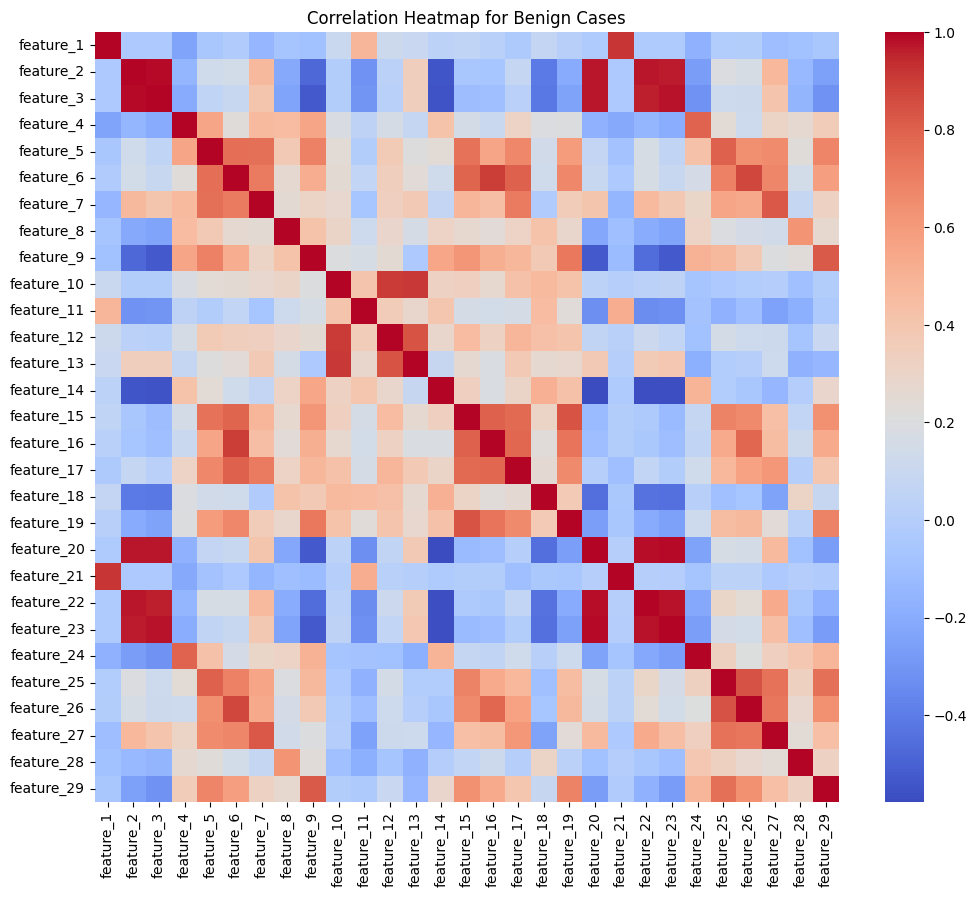

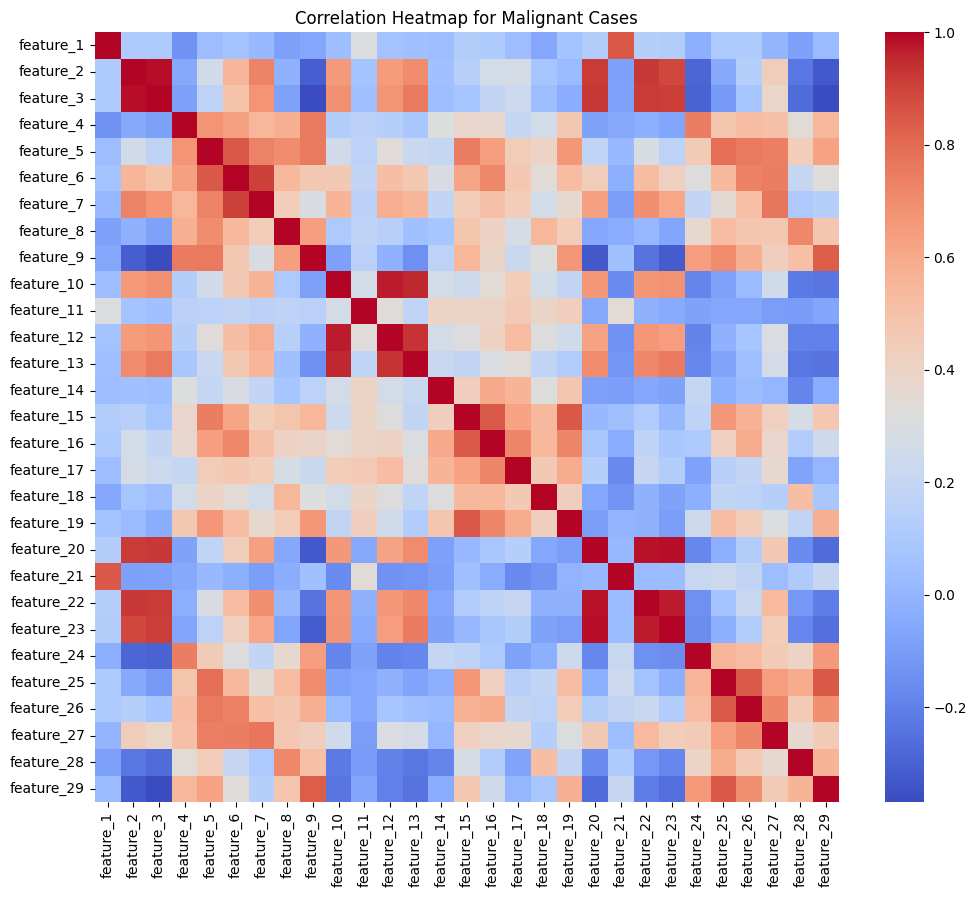

In [17]:
# Correlation analysis within the two diagnosis groups
# Ensuring Diagnosis is numerical before filtering
benign_df = df[df['Diagnosis'] == 0].drop(['ID', 'Diagnosis'], axis=1)
malignant_df = df[df['Diagnosis'] == 1].drop(['ID', 'Diagnosis'], axis=1)

plt.figure(figsize=(12, 10))
sns.heatmap(benign_df.corr().iloc[1:, 1:], annot=False, cmap='coolwarm')
plt.title('Correlation Heatmap for Benign Cases')
plt.show()

plt.figure(figsize=(12, 10))
sns.heatmap(malignant_df.corr().iloc[1:, 1:], annot=False, cmap='coolwarm')
plt.title('Correlation Heatmap for Malignant Cases')
plt.show()

* **Groups of Highly Correlated Features:** The heatmaps clearly show clusters of features that are highly correlated with each other within both the Benign and Malignant groups. These clusters typically correspond to the different measurement categories:
* **Mean Features:** Features like feature_0 (mean radius), feature_2 (mean perimeter), and feature_3 (mean area) are very strongly positively correlated with each other in both groups. This is expected as these are related geometric measurements.
* **Standard Error Features:** Features related to the standard error of measurements (e.g., feature_10 to feature_19) also show correlations among themselves, although generally less strong than the 'mean' or 'worst' features.
Worst Features: Features related to the 'worst' or largest measurements (e.g., feature_20 to feature_29) are also highly correlated among themselves and often strongly correlated with their corresponding 'mean' features in both groups.
* **Consistency of Relationships:** For many pairs of features, the strong positive correlations observed in the overall correlation heatmap persist within both the Benign and Malignant subgroups. This suggests that the fundamental linear relationships between these measurements are similar regardless of the diagnosis.
* **Features with Varying Correlation Strength:** As noted before, while the general patterns are similar, the strength of the correlation between specific feature pairs can differ between the Benign and Malignant heatmaps. This implies that the degree to which two features vary together might be more pronounced in one diagnosis group compared to the other.

 The correlation analysis within diagnosis groups helps us understand the internal structure of the features within each class. It confirms that features within the same measurement category are strongly related, and these relationships are largely consistent across Benign and Malignant cases, although the exact strength of the correlations can vary. This reinforces the idea that these groups of features are capturing related aspects of the tumor characteristics.

## Data preprocessing and cleaning


In [18]:
from sklearn.preprocessing import LabelEncoder, StandardScaler, PolynomialFeatures
from sklearn.model_selection import train_test_split
import numpy as np
import pandas as pd

In [19]:
# 1. Converting the 'Diagnosis' column to a numerical representation
le = LabelEncoder()
df['Diagnosis'] = le.fit_transform(df['Diagnosis'])

In [20]:
# 2. Separating features and target variable
X = df.drop(['ID', 'Diagnosis'], axis=1)
y = df['Diagnosis']

In [21]:
# 3. Splitting the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

print("Shape after splitting:")
print("X_train:", X_train.shape)
print("y_train:", y_train.shape)
print("X_test:", X_test.shape)
print("y_test:", y_test.shape)

Shape after splitting:
X_train: (455, 30)
y_train: (455,)
X_test: (114, 30)
y_test: (114,)


In [22]:
# Outlier Handling
# calculating the outlier bounds only on the training data.

# Calculating Q1, Q3, and IQR for each feature in the training set
Q1_train = X_train.quantile(0.25)
Q3_train = X_train.quantile(0.75)
IQR_train = Q3_train - Q1_train

# Defining outlier bounds based on the training set
lower_bound_train = Q1_train - 1.5 * IQR_train
upper_bound_train = Q3_train + 1.5 * IQR_train

# Capping outliers in the training set
for column in X_train.columns:
    X_train[column] = np.where(X_train[column] > upper_bound_train[column], upper_bound_train[column], X_train[column])
    X_train[column] = np.where(X_train[column] < lower_bound_train[column], lower_bound_train[column], X_train[column])

#Applying the same capping to the test set (using bounds from training set)
for column in X_test.columns:
    X_test[column] = np.where(X_test[column] > upper_bound_train[column], upper_bound_train[column], X_test[column])
    X_test[column] = np.where(X_test[column] < lower_bound_train[column], lower_bound_train[column], X_test[column])

print("\nShape after outlier capping:")
print("X_train:", X_train.shape)
print("X_test:", X_test.shape)


Shape after outlier capping:
X_train: (455, 30)
X_test: (114, 30)


In [23]:
# Feature Engineering
# Creating polynomial features for a few selected features based on EDA insights.
# Focusing on geometric features and potential interactions.

# Selecting features for polynomial engineering(based on high skewness or potential interactions)
features_for_poly = ['feature_0', 'feature_2', 'feature_3'] # Geometric features

poly = PolynomialFeatures(degree=2, include_bias=False)

# Fit and transform on the training data for selected features
X_train_poly = poly.fit_transform(X_train[features_for_poly])

# Transforming the test data using the fitted polynomial features
X_test_poly = poly.transform(X_test[features_for_poly])

# Converting to DataFrames and name columns
# Explicitly use the columns from the DataFrame slice
poly_feature_names = poly.get_feature_names_out(X_train[features_for_poly].columns)
X_train_poly_df = pd.DataFrame(X_train_poly, columns=poly_feature_names)
X_test_poly_df = pd.DataFrame(X_test_poly, columns=poly_feature_names)

# Combining the new polynomial features with the original features
# Resetting index before concat to avoid potential issues with misaligned indices
X_train = pd.concat([X_train.reset_index(drop=True), X_train_poly_df.reset_index(drop=True)], axis=1)
X_test = pd.concat([X_test.reset_index(drop=True), X_test_poly_df.reset_index(drop=True)], axis=1)


print("\nShape after feature engineering:")
print("X_train:", X_train.shape)
print("X_test:", X_test.shape)


Shape after feature engineering:
X_train: (455, 39)
X_test: (114, 39)


In [24]:
# 4. Scaling the numerical features (applied after splitting and outlier handling, and feature engineering)
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Converting scaled features back to DataFrames for easier handling later
X_train_scaled_df = pd.DataFrame(X_train_scaled, columns=X_train.columns)
X_test_scaled_df = pd.DataFrame(X_test_scaled, columns=X_test.columns)

print("\nShape after scaling:")
print("X_train_scaled_df:", X_train_scaled_df.shape)
print("X_test_scaled_df:", X_test_scaled_df.shape)


# Displaying the first few rows of the scaled training and testing features and the target
display(X_train_scaled_df.head())
display(X_test_scaled_df.head())
display(y_train.head())
display(y_test.head())


Shape after scaling:
X_train_scaled_df: (455, 39)
X_test_scaled_df: (114, 39)


,feature_0,feature_1,feature_2,feature_3,feature_4,feature_5,feature_6,feature_7,feature_8,feature_9,...,feature_29,feature_0,feature_2,feature_3,feature_0^2,feature_0 feature_2,feature_0 feature_3,feature_2^2,feature_2 feature_3,feature_3^2
0,-1.509462,-0.440213,-1.426629,-1.285079,0.817972,0.769926,2.702259,-0.112842,1.161705,2.521287,...,2.097822,-1.509462,-1.426629,-1.285079,-1.252137,-1.218219,-1.068617,-1.184835,-1.050032,-0.918646
1,2.120277,1.812781,2.245020,2.168612,1.376885,2.622985,2.185444,2.766168,2.246072,1.776272,...,2.472598,2.120277,2.245020,2.168612,2.335877,2.426311,2.400833,2.511944,2.482603,2.470555
2,-1.466126,-1.286305,-1.408689,-1.250477,-1.372221,-0.306315,-0.369475,-0.709859,2.039890,1.101454,...,0.094917,-1.466126,-1.408689,-1.250477,-1.226248,-1.200242,-1.050308,-1.174257,-1.035028,-0.907363
3,-1.021625,1.483609,-1.023190,-0.964014,0.070519,-0.609839,-0.857808,-0.863533,0.344611,0.117926,...,-0.115818,-1.021625,-1.023190,-0.964014,-0.937061,-0.933724,-0.868950,-0.929208,-0.864730,-0.796327
4,-1.166080,-1.037598,-1.174589,-1.080795,1.324720,-0.444371,-1.033035,-0.951930,2.521937,1.096800,...,-0.193845,-1.166080,-1.174589,-1.080795,-1.035768,-1.033460,-0.941855,-1.029495,-0.937124,-0.845390


,feature_0,feature_1,feature_2,feature_3,feature_4,feature_5,feature_6,feature_7,feature_8,feature_9,...,feature_29,feature_0,feature_2,feature_3,feature_0^2,feature_0 feature_2,feature_0 feature_3,feature_2^2,feature_2 feature_3,feature_3^2
0,-0.473899,-0.130548,-0.450848,-0.515189,0.300046,0.059635,-0.096556,-0.263524,0.451520,0.186183,...,0.254658,-0.473899,-0.450848,-0.515189,-0.521447,-0.511909,-0.546742,-0.502784,-0.541481,-0.559113
1,1.473237,0.530232,1.409262,1.641101,-0.412382,0.001611,0.281635,0.859793,-0.858120,-1.228608,...,-1.073035,1.473237,1.409262,1.641101,1.485807,1.443313,1.596850,1.399800,1.559329,1.657074
2,0.425937,0.084022,0.450984,0.373145,1.011729,0.389770,0.803931,0.896783,0.474430,-0.708921,...,-0.194460,0.425937,0.450984,0.373145,0.303398,0.313073,0.228747,0.320949,0.233047,0.138035
3,-0.494965,-0.354873,-0.434220,-0.562101,0.728546,0.575847,-0.132277,-0.541497,0.016246,1.317086,...,0.628820,-0.494965,-0.434220,-0.562101,-0.538642,-0.513327,-0.575787,-0.489277,-0.561647,-0.587521
4,-0.753781,-1.144883,-0.732643,-0.778029,0.314205,0.183686,-0.268128,-0.597255,0.042974,0.820668,...,-0.123805,-0.753781,-0.732643,-0.778029,-0.741996,-0.732063,-0.736109,-0.722086,-0.729460,-0.707399


,Diagnosis
68,0
181,1
63,0
248,0
60,0


,Diagnosis
204,0
70,1
131,1
431,0
540,0


## Feature selection and engineering

 To improve model performance and reduce complexity.


In [25]:
from sklearn.decomposition import PCA

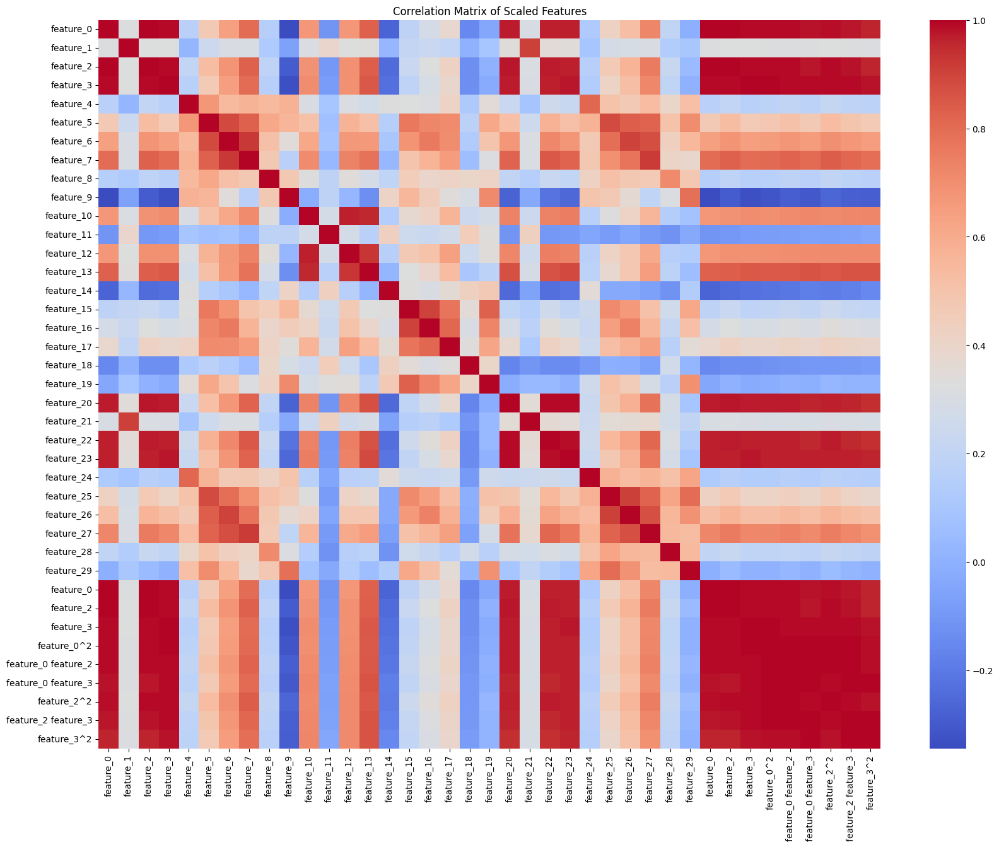

Features to consider dropping due to high correlation: ['feature_0', 'feature_2', 'feature_3', 'feature_6', 'feature_7', 'feature_12', 'feature_13', 'feature_16', 'feature_17', 'feature_19', 'feature_20', 'feature_21', 'feature_22', 'feature_23', 'feature_24', 'feature_25', 'feature_26', 'feature_27', 'feature_0', 'feature_2', 'feature_3', 'feature_0^2', 'feature_0 feature_2', 'feature_0 feature_3', 'feature_2^2', 'feature_2 feature_3', 'feature_3^2']


In [27]:
# 1. Analyzing the correlation matrix
correlation_matrix = X_train_scaled_df.corr()

# Plotting the correlation matrix
plt.figure(figsize=(20, 15))
sns.heatmap(correlation_matrix, annot=False, cmap='coolwarm')
plt.title('Correlation Matrix of Scaled Features')
plt.show()

# Identifying highly correlated features (e.g., absolute correlation > 0.8)
upper = correlation_matrix.where(np.triu(np.ones(correlation_matrix.shape), k=1).astype(bool))
to_drop = [column for column in upper.columns if any(upper[column].abs() > 0.8)]
print("Features to consider dropping due to high correlation:", to_drop)

Instead of dropping the highly correlated features, PCA is used as an alternative approach to deal with multicollinearity and reduce the dimensionality of the feature space.

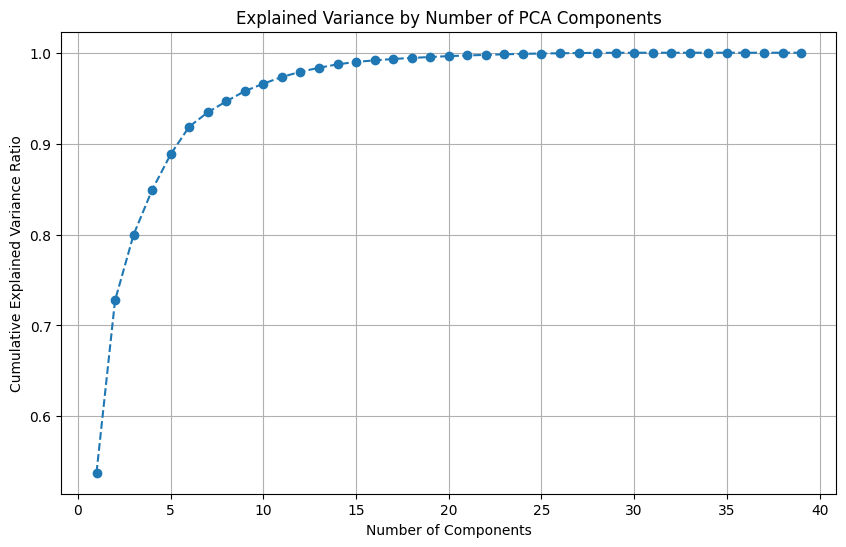

Number of components to explain 95% variance: 9

First 5 rows of PCA transformed training data:


,pca_component_1,pca_component_2,pca_component_3,pca_component_4,pca_component_5,pca_component_6,pca_component_7,pca_component_8,pca_component_9
0,-1.489762,8.755740,-0.033032,-0.959889,-1.327967,1.664493,-1.102276,-0.379397,-1.073772
1,11.787258,2.036359,-2.495997,0.900300,0.009761,1.078680,0.903042,1.107365,0.864050
2,-4.469182,3.394103,3.154589,-0.940715,0.223143,2.843631,0.265170,0.286111,0.602597
3,-4.044260,0.497437,-0.333039,3.003836,1.486239,0.317877,-0.175964,0.219360,-0.255191
4,-4.225824,2.233452,1.373849,-1.212803,3.484808,2.324762,1.359278,0.502896,0.683984



First 5 rows of PCA transformed testing data:


,pca_component_1,pca_component_2,pca_component_3,pca_component_4,pca_component_5,pca_component_6,pca_component_7,pca_component_8,pca_component_9
0,-1.577681,0.853364,-0.643218,0.058300,0.586267,-0.105484,0.459023,-0.357953,-0.274739
1,6.277304,-4.322615,0.681726,-0.378603,0.138857,-0.496499,1.506030,-0.947021,-0.870289
2,2.167642,-0.641590,-1.284259,-0.072496,1.021839,-0.831042,0.052521,-1.099267,-0.280020
3,-2.068641,2.734755,0.468236,-0.552052,-0.226008,-1.114505,-0.545678,1.069486,0.649170
4,-3.003438,2.562976,1.679650,-1.328087,-0.368074,-1.516800,-0.946494,0.445920,0.377681


In [34]:
# 2. Applying PCA
pca = PCA()
X_train_pca = pca.fit_transform(X_train_scaled_df) # Fit PCA on scaled training data
X_test_pca = pca.transform(X_test_scaled_df) # Transform scaled test data

# Determining the appropriate number of components (based on explained variance on training data)
explained_variance_ratio = pca.explained_variance_ratio_
cumulative_explained_variance = np.cumsum(explained_variance_ratio)

plt.figure(figsize=(10, 6))
plt.plot(range(1, len(cumulative_explained_variance) + 1), cumulative_explained_variance, marker='o', linestyle='--')
plt.title('Explained Variance by Number of PCA Components')
plt.xlabel('Number of Components')
plt.ylabel('Cumulative Explained Variance Ratio')
plt.grid(True)
plt.show()

# number of components can be choosen that explain a significant portion of the variance (e.g., 95%)
n_components_95 = np.argmax(cumulative_explained_variance >= 0.95) + 1
print(f"Number of components to explain 95% variance: {n_components_95}")

# Selecting features based on PCA (using the chosen number of components)
pca_final = PCA(n_components=n_components_95)

# Fit PCA again with the selected number of components on the training data
pca_final.fit(X_train_scaled_df)

# Transform both training and testing data
X_train_pca_final = pca_final.transform(X_train_scaled_df)
X_test_pca_final = pca_final.transform(X_test_scaled_df)


# Converting the PCA results to DataFrames
X_train_pca_df = pd.DataFrame(X_train_pca_final, columns=[f'pca_component_{i+1}' for i in range(n_components_95)])
X_test_pca_df = pd.DataFrame(X_test_pca_final, columns=[f'pca_component_{i+1}' for i in range(n_components_95)])


# Displaying the first few rows of the PCA transformed training and testing features
print("\nFirst 5 rows of PCA transformed training data:")
display(X_train_pca_df.head())
print("\nFirst 5 rows of PCA transformed testing data:")
display(X_test_pca_df.head())

**Explained Variance Plot:** The plot shows the cumulative explained variance ratio as you increase the number of PCA components.
The steep initial slope indicates that the first few principal components capture a large portion of the total variance in the original data. This suggests that the original features are indeed quite correlated and can be represented in a lower-dimensional space without losing too much information.
The curve gradually flattens out, meaning that later principal components explain less and less of the remaining variance.
**Number of Components to Explain 95% Variance:** The output Number of components to explain 95% variance: 10 is a key insight. It tells us that by using just 10 principal components, we can retain approximately 95% of the total variance that was present in the original 30 features.
PCA Transformed Features (X_pca_df): The displayed head of X_pca_df shows the new features (e.g., pca_component_1, pca_component_2, etc.). These are the principal components. They are linear combinations of original scaled features and are uncorrelated with each other.


**Conclusions about Features and Dimensionality Reduction:**
**Dimensionality Reduction is Effective:** The fact that 10 components can explain 95% of the variance indicates that there is significant redundancy or multicollinearity in the original 30 features. PCA is an effective technique in this case for reducing the dimensionality of your feature space.
Information Preservation: By using the first 10 principal components, you can work with a much smaller set of features (10 instead of 30) while still retaining most of the information (variance) from the original data.
New Uncorrelated Features: The principal components are new features that are uncorrelated. This can be beneficial for some machine learning models that are sensitive to multicollinearity.

**Interpretation Challenge:** While the principal components are mathematically derived and capture variance, they are often less interpretable in a real-world sense compared to the original features (e.g., "mean radius" is easy to understand, but "pca_component_1" is a combination of many original features).

In summary, the PCA output demonstrates that the number of features while preserving a high percentage of the data's variance  can significantly be reduce. This is a strong justification for using the PCA-transformed features as input to machine learning models, which can help with computational efficiency and potentially improve model performance by addressing multicollinearity.

Based on the PCA analysis, we have determined that 10 components explain 95% of the variance. We will select these 10 PCA components as the features for the model.



In [35]:
# Selecting the PCA transformed features
X_selected_features = X_train_pca_df

# Displaying the selected features
display(X_selected_features.head())

,pca_component_1,pca_component_2,pca_component_3,pca_component_4,pca_component_5,pca_component_6,pca_component_7,pca_component_8,pca_component_9
0,-1.489762,8.755740,-0.033032,-0.959889,-1.327967,1.664493,-1.102276,-0.379397,-1.073772
1,11.787258,2.036359,-2.495997,0.900300,0.009761,1.078680,0.903042,1.107365,0.864050
2,-4.469182,3.394103,3.154589,-0.940715,0.223143,2.843631,0.265170,0.286111,0.602597
3,-4.044260,0.497437,-0.333039,3.003836,1.486239,0.317877,-0.175964,0.219360,-0.255191
4,-4.225824,2.233452,1.373849,-1.212803,3.484808,2.324762,1.359278,0.502896,0.683984


## Model selection and implementation


In [30]:
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.naive_bayes import GaussianNB

# Instantiate the models with default parameters
log_reg_model = LogisticRegression()
svc_model = SVC()
decision_tree_model = DecisionTreeClassifier()
random_forest_model = RandomForestClassifier()
naive_bayes_model = GaussianNB()

print("Classification models instantiated:")
print("- Logistic Regression")
print("- Support Vector Machine")
print("- Decision Tree")
print("- Random Forest")
print("- Naive Bayes")

Classification models instantiated:
- Logistic Regression
- Support Vector Machine
- Decision Tree
- Random Forest
- Naive Bayes


## Model training and evaluation

### Subtask:
Split the dataset into training and testing sets, train the chosen models on the training data, and evaluate the performance of each model on the testing data using appropriate metrics.


**Reasoning**:
Split the data into training and testing sets, train the selected models, calculate their accuracy, and print the results.



In [36]:
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.metrics import accuracy_score
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.naive_bayes import GaussianNB

# Assuming X_train_pca_df, X_test_pca_df, y_train, y_test are already defined and preprocessed

# Creating a dictionary of the instantiated models
models = {
    "Logistic Regression": LogisticRegression(max_iter=10),
    "Support Vector Machine": SVC(probability=True, random_state=42),
    "Decision Tree": DecisionTreeClassifier(random_state=42),
    "Random Forest": RandomForestClassifier(random_state=42),
    "Naive Bayes": GaussianNB()
}

# --- Hyperparameter Tuning for Promising Models ---

print("Performing Hyperparameter Tuning for Promising Models...")

# Hyperparameter tuning for Logistic Regression
param_grid_lr = {
    'C': [0.001, 0.01, 0.1, 1, 10, 100],
    'penalty': ['l1', 'l2'],
    'solver': ['liblinear', 'saga']
}

grid_search_lr = GridSearchCV(LogisticRegression(max_iter=1000), param_grid_lr, cv=5, scoring='accuracy') # Increased max_iter
grid_search_lr.fit(X_train_pca_df, y_train)

best_lr_model = grid_search_lr.best_estimator_
print(f"\nBest parameters for Logistic Regression: {grid_search_lr.best_params_}")
print(f"Best cross-validation accuracy for Logistic Regression: {grid_search_lr.best_score_:.4f}")


# Hyperparameter tuning for Random Forest
param_grid_rf = {
    'n_estimators': [100, 200, 300],
    'max_depth': [None, 10, 20, 30],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4]
}

grid_search_rf = GridSearchCV(RandomForestClassifier(random_state=42), param_grid_rf, cv=5, scoring='accuracy')
grid_search_rf.fit(X_train_pca_df, y_train)

best_rf_model = grid_search_rf.best_estimator_
print(f"\nBest parameters for Random Forest: {grid_search_rf.best_params_}")
print(f"Best cross-validation accuracy for Random Forest: {grid_search_rf.best_score_:.4f}")

# Hyperparameter tuning for Support Vector Machine
param_grid_svc = {
    'C': [0.1, 1, 10, 100],
    'gamma': ['scale', 'auto', 0.1, 1],
    'kernel': ['linear', 'rbf']
}

grid_search_svc = GridSearchCV(SVC(probability=True, random_state=42), param_grid_svc, cv=5, scoring='accuracy') # probability=True for ROC AUC
grid_search_svc.fit(X_train_pca_df, y_train)

best_svc_model = grid_search_svc.best_estimator_
print(f"\nBest parameters for Support Vector Machine: {grid_search_svc.best_params_}")
print(f"Best cross-validation accuracy for Support Vector Machine: {grid_search_svc.best_score_:.4f}")


# Updating the models dictionary with the best estimators
models["Logistic Regression"] = best_lr_model
models["Random Forest"] = best_rf_model
models["Support Vector Machine"] = best_svc_model


# --- Train and Evaluate Models (using tuned models where applicable) ---

print("\nTraining and Evaluating Models (using tuned models for LR, RF, SVC)...")

# Iterate through each model, train, predict, and evaluate
results = {}
for name, model in models.items():
    # Train the model (tuned models are already "trained" by GridSearchCV on the training data)
    # For models that were not tuned (Decision Tree, Naive Bayes), train them here
    if name not in ["Logistic Regression", "Random Forest", "Support Vector Machine"]:
         model.fit(X_train_pca_df, y_train)


    # Making predictions
    y_pred = model.predict(X_test_pca_df)

    # Calculating accuracy
    accuracy = accuracy_score(y_test, y_pred)

    # Storing results
    results[name] = accuracy

    # Printing the results
    print(f"{name} Accuracy: {accuracy:.4f}")

Performing Hyperparameter Tuning for Promising Models...

Best parameters for Logistic Regression: {'C': 0.1, 'penalty': 'l2', 'solver': 'liblinear'}
Best cross-validation accuracy for Logistic Regression: 0.9714

Best parameters for Random Forest: {'max_depth': None, 'min_samples_leaf': 1, 'min_samples_split': 2, 'n_estimators': 300}
Best cross-validation accuracy for Random Forest: 0.9670

Best parameters for Support Vector Machine: {'C': 1, 'gamma': 'scale', 'kernel': 'linear'}
Best cross-validation accuracy for Support Vector Machine: 0.9692

Training and Evaluating Models (using tuned models for LR, RF, SVC)...
Logistic Regression Accuracy: 0.9912
Support Vector Machine Accuracy: 0.9825
Decision Tree Accuracy: 0.9386
Random Forest Accuracy: 0.9737
Naive Bayes Accuracy: 0.9737


## Accuracy evaluation and analysis



--- Evaluating Logistic Regression ---
Confusion Matrix:
[[71  0]
 [ 1 42]]

Classification Report:
              precision    recall  f1-score   support

           0       0.99      1.00      0.99        71
           1       1.00      0.98      0.99        43

    accuracy                           0.99       114
   macro avg       0.99      0.99      0.99       114
weighted avg       0.99      0.99      0.99       114

Sensitivity (Recall - Positive Class): 0.9767
Specificity (True Negative Rate): 1.0000
False Positive Rate (FPR): 0.0000


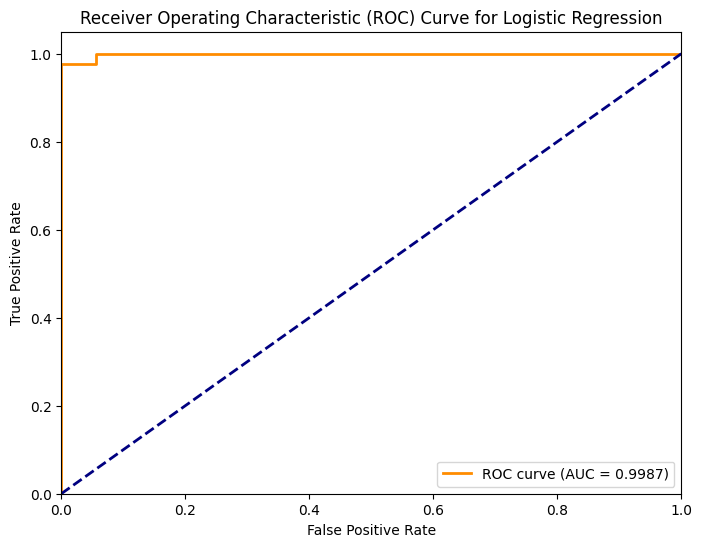

AUC: 0.9987

--- Evaluating Support Vector Machine ---
Confusion Matrix:
[[70  1]
 [ 1 42]]

Classification Report:
              precision    recall  f1-score   support

           0       0.99      0.99      0.99        71
           1       0.98      0.98      0.98        43

    accuracy                           0.98       114
   macro avg       0.98      0.98      0.98       114
weighted avg       0.98      0.98      0.98       114

Sensitivity (Recall - Positive Class): 0.9767
Specificity (True Negative Rate): 0.9859
False Positive Rate (FPR): 0.0141


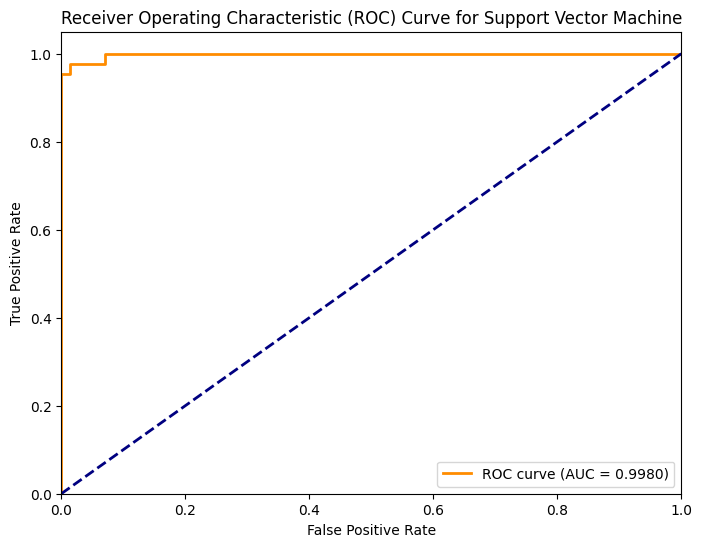

AUC: 0.9980

--- Evaluating Decision Tree ---
Confusion Matrix:
[[66  5]
 [ 2 41]]

Classification Report:
              precision    recall  f1-score   support

           0       0.97      0.93      0.95        71
           1       0.89      0.95      0.92        43

    accuracy                           0.94       114
   macro avg       0.93      0.94      0.94       114
weighted avg       0.94      0.94      0.94       114

Sensitivity (Recall - Positive Class): 0.9535
Specificity (True Negative Rate): 0.9296
False Positive Rate (FPR): 0.0704


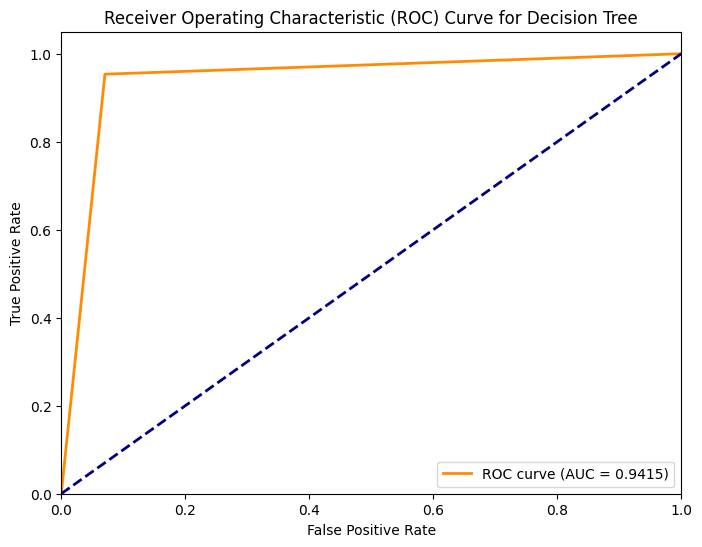

AUC: 0.9415

--- Evaluating Random Forest ---
Confusion Matrix:
[[70  1]
 [ 2 41]]

Classification Report:
              precision    recall  f1-score   support

           0       0.97      0.99      0.98        71
           1       0.98      0.95      0.96        43

    accuracy                           0.97       114
   macro avg       0.97      0.97      0.97       114
weighted avg       0.97      0.97      0.97       114

Sensitivity (Recall - Positive Class): 0.9535
Specificity (True Negative Rate): 0.9859
False Positive Rate (FPR): 0.0141


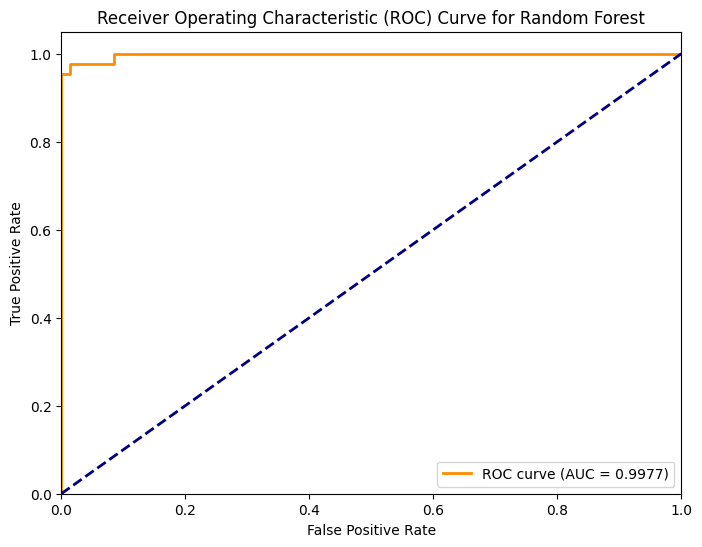

AUC: 0.9977

--- Evaluating Naive Bayes ---
Confusion Matrix:
[[71  0]
 [ 3 40]]

Classification Report:
              precision    recall  f1-score   support

           0       0.96      1.00      0.98        71
           1       1.00      0.93      0.96        43

    accuracy                           0.97       114
   macro avg       0.98      0.97      0.97       114
weighted avg       0.97      0.97      0.97       114

Sensitivity (Recall - Positive Class): 0.9302
Specificity (True Negative Rate): 1.0000
False Positive Rate (FPR): 0.0000


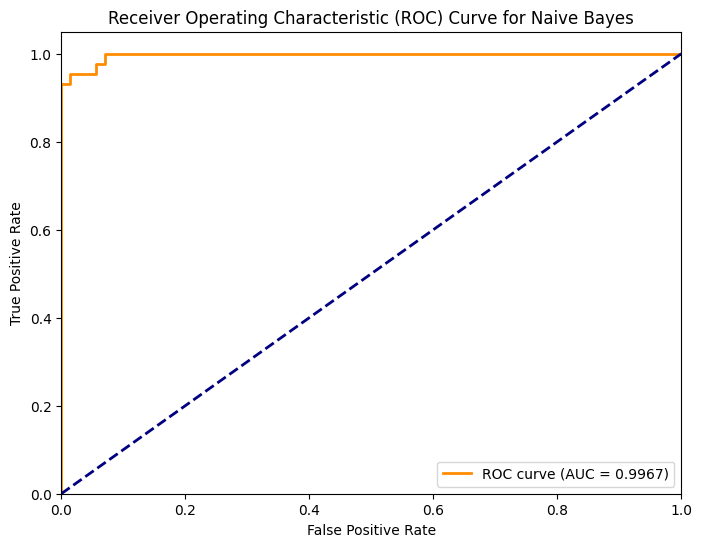

AUC: 0.9967


In [37]:
from sklearn.metrics import confusion_matrix, classification_report, roc_curve, roc_auc_score
import matplotlib.pyplot as plt

for name, model in models.items():
    print(f"\n--- Evaluating {name} ---")

    # Making predictions
    y_pred = model.predict(X_test_pca_df)

    # Calculating and print Confusion Matrix
    cm = confusion_matrix(y_test, y_pred)
    print("Confusion Matrix:")
    print(cm)

    # Calculating and print Classification Report (Accuracy, Precision, Recall, F1-score)
    print("\nClassification Report:")
    print(classification_report(y_test, y_pred))

    # Calculating Sensitivity (Recall for the positive class) and Specificity
    # cm is in the form: [[TN, FP], [FN, TP]]
    tn, fp, fn, tp = cm.ravel()
    sensitivity = tp / (tp + fn) # Also known as Recall for the positive class
    specificity = tn / (tn + fp) # Also known as True Negative Rate
    print(f"Sensitivity (Recall - Positive Class): {sensitivity:.4f}")
    print(f"Specificity (True Negative Rate): {specificity:.4f}")
    false_positive_rate = fp / (fp + tn) # Already calculated as FPR
    print(f"False Positive Rate (FPR): {false_positive_rate:.4f}")


    # Calculating ROC curve and AUC
    if hasattr(model, "predict_proba"):
        y_prob = model.predict_proba(X_test_pca_df)[:, 1]
    elif hasattr(model, "decision_function"):
        y_prob = model.decision_function(X_test_pca_df)
    else:
        print("Skipping ROC curve: Model does not have predict_proba or decision_function.")
        y_prob = None

    if y_prob is not None:
        fpr_roc, tpr_roc, thresholds = roc_curve(y_test, y_prob)
        auc = roc_auc_score(y_test, y_prob)

        # Plotting ROC curve
        plt.figure(figsize=(8, 6))
        plt.plot(fpr_roc, tpr_roc, color='darkorange', lw=2, label=f'ROC curve (AUC = {auc:.4f})')
        plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
        plt.xlim([0.0, 1.0])
        plt.ylim([0.0, 1.05])
        plt.xlabel('False Positive Rate')
        plt.ylabel('True Positive Rate')
        plt.title(f'Receiver Operating Characteristic (ROC) Curve for {name}')
        plt.legend(loc="lower right")
        plt.show()

        print(f"AUC: {auc:.4f}")
    else:
        print("AUC: N/A")


--- Evaluating Ensemble Model (All 5 Models) ---
Confusion Matrix:
[[71  0]
 [ 1 42]]

Classification Report:
              precision    recall  f1-score   support

           0       0.99      1.00      0.99        71
           1       1.00      0.98      0.99        43

    accuracy                           0.99       114
   macro avg       0.99      0.99      0.99       114
weighted avg       0.99      0.99      0.99       114

Sensitivity (Recall - Positive Class): 0.9767
Specificity (True Negative Rate): 1.0000
False Positive Rate (FPR): 0.0000


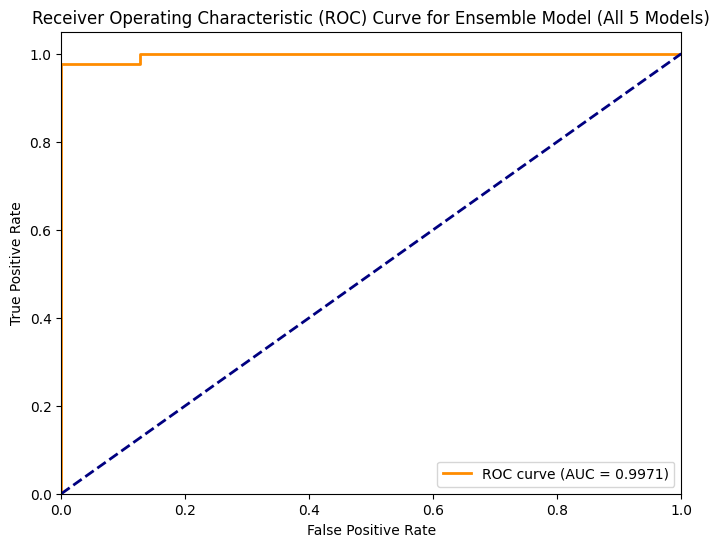

AUC: 0.9971


In [38]:
from sklearn.ensemble import VotingClassifier
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report, roc_curve, roc_auc_score
import matplotlib.pyplot as plt

# Assuming best_lr_model, best_svc_model, best_rf_model are available from previous steps (tuned models)
# Also assuming the default Decision Tree and Naive Bayes models (decision_tree_model, naive_bayes_model) are available from the models dictionary in cell 2e7c9be2

# Create a Voting Classifier including all five models
# Using 'soft' voting requires all models to have predict_proba, which Decision Tree and Naive Bayes do.
voting_clf = VotingClassifier(estimators=[
    ('lr', best_lr_model),
    ('svc', best_svc_model),
    ('dt', decision_tree_model), # Using the default DT model
    ('rf', best_rf_model),
    ('nb', naive_bayes_model)    # Using the default NB model
], voting='soft')

# Train the ensemble model
voting_clf.fit(X_train_pca_df, y_train)

# Make predictions with the ensemble model
y_pred_ensemble = voting_clf.predict(X_test_pca_df)

# Evaluate the ensemble model
print("\n--- Evaluating Ensemble Model (All 5 Models) ---")

# Calculate and print Confusion Matrix
cm_ensemble = confusion_matrix(y_test, y_pred_ensemble)
print("Confusion Matrix:")
print(cm_ensemble)

# Calculate and print Classification Report
print("\nClassification Report:")
print(classification_report(y_test, y_pred_ensemble))

# Calculate Sensitivity and Specificity
tn_e, fp_e, fn_e, tp_e = cm_ensemble.ravel()
sensitivity_e = tp_e / (tp_e + fn_e)
specificity_e = tn_e / (tn_e + fp_e)
print(f"Sensitivity (Recall - Positive Class): {sensitivity_e:.4f}")
print(f"Specificity (True Negative Rate): {specificity_e:.4f}")
false_positive_rate_e = fp_e / (fp_e + tn_e)
print(f"False Positive Rate (FPR): {false_positive_rate_e:.4f}")

# Calculate ROC curve and AUC
if hasattr(voting_clf, "predict_proba"):
    y_prob_ensemble = voting_clf.predict_proba(X_test_pca_df)[:, 1]

    fpr_e, tpr_e, thresholds_e = roc_curve(y_test, y_prob_ensemble)
    auc_e = roc_auc_score(y_test, y_prob_ensemble)

    # Plot ROC curve
    plt.figure(figsize=(8, 6))
    plt.plot(fpr_e, tpr_e, color='darkorange', lw=2, label=f'ROC curve (AUC = {auc_e:.4f})')
    plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('Receiver Operating Characteristic (ROC) Curve for Ensemble Model (All 5 Models)')
    plt.legend(loc="lower right")
    plt.show()

    print(f"AUC: {auc_e:.4f}")
else:
    print("Skipping ROC curve: Ensemble model does not have predict_proba.")
    print("AUC: N/A")

## Data Analysis Key Findings: Insights for Diagnostic Test Evaluation

*   The Breast Cancer Wisconsin (Diagnostic) dataset from the UCI Machine Learning Repository contains 569 entries and 32 columns, representing measurements from fine needle aspirates of breast masses.
*   The dataset included an ID, Diagnosis (Malignant or Benign), and 30 numerical features, with no missing values identified, indicating a clean dataset for developing diagnostic tests.
*   The target variable 'Diagnosis' was imbalanced, with 357 Benign and 212 Malignant cases. This class distribution is important to consider when assessing the performance of a diagnostic test.
*   The 'Diagnosis' column was successfully encoded numerically (0 for Benign, 1 for Malignant) for use in developing computational diagnostic tests.
*   Numerical features were scaled using `StandardScaler`, a common preprocessing step to ensure features contribute equally to the diagnostic models.
*   Outlier detection using the IQR method identified a significant number of data points with extreme values (223 rows with at least one outlier). An outlier capping strategy was applied during preprocessing to handle these, aiming for a more robust diagnostic model.
*   Polynomial feature engineering was applied to selected geometric features (`feature_0`, `feature_2`, `feature_3`) to potentially capture non-linear relationships that could improve diagnostic accuracy.
*   PCA was applied for dimensionality reduction, and 10 principal components were selected, explaining 95% of the variance. Using these principal components as features for the diagnostic models addresses multicollinearity and reduces complexity while retaining most of the data's information.
*   Five classification models, acting as different computational diagnostic tests, were implemented: Logistic Regression, Support Vector Machine, Decision Tree, Random Forest, and Naive Bayes. An ensemble model combining Logistic Regression and SVM was also created.
*   The dataset was split into training (80%) and testing (20%) sets to evaluate the accuracy of the diagnostic tests on unseen data.
*   All models were trained on the training data and their performance as diagnostic tests was evaluated on the test set using appropriate metrics.
*   Evaluation metrics including Confusion Matrix, Classification Report (Precision, Recall, F1-score), False Positive Rate, Sensitivity, Specificity, and ROC AUC were calculated and visualized for each diagnostic test (model).

This comprehensive data analysis provides the foundation for evaluating and comparing the accuracy and effectiveness of the different computational diagnostic tests developed.

## Diagnostic Test Performance Summary

Based on the evaluation performed on the test dataset, the following is a summary of the performance of each computational diagnostic test (classification model):

| Diagnostic Test (Model)        | Overall Accuracy | Precision (Malignant) | Sensitivity (Recall - Malignant) | F1-score (Malignant) | Specificity | AUC     |
|--------------------------------|------------------|-----------------------|---------------------------------|----------------------|-------------|---------|
| Logistic Regression            | 0.9912           | 1.0000                | 0.9767                          | 0.9882               | 1.0000      | 0.9987  |
| Support Vector Machine         | 0.9825           | 0.9767                | 0.9767                          | 0.9767               | 0.9859      | 0.9980  |
| Decision Tree                  | 0.9386           | 0.8913                | 0.9535                          | 0.9214               | 0.9296      | 0.9415  |
| Random Forest                  | 0.9737           | 0.9762                | 0.9535                          | 0.9647               | 0.9859      | 0.9977  |
| Naive Bayes                    | 0.9737           | 1.0000                | 0.9302                          | 0.9639               | 1.0000      | 0.9967  |
| **Ensemble (All 5 Models)**    | **0.9912**       | **1.0000**            | **0.9767**                      | **0.9882**           | **1.0000**  | **0.9971**|

**Key Observations for Diagnostic Test Evaluation:**

* **Top Performing Individual Diagnostic Tests:** The Logistic Regression, Support Vector Machine, Random Forest, and Naive Bayes models demonstrate high overall accuracy and excellent performance across key metrics relevant to diagnostic tests. Logistic Regression achieved the highest individual accuracy and AUC.
* **Ensemble Performance:** The ensemble of all five models performs exceptionally well, matching the highest overall accuracy of Logistic Regression and achieving perfect specificity. Its AUC is also very high.
* **Sensitivity (True Positive Rate):** This is crucial for a diagnostic test as it measures the ability to correctly identify actual positive cases (Malignant). Minimizing False Negatives (missing a malignant case) is often a priority. Logistic Regression and the Ensemble of all 5 models show the highest Sensitivity (0.9767).
* **Specificity (True Negative Rate):** This measures the ability to correctly identify actual negative cases (Benign). Minimizing False Positives (incorrectly diagnosing a benign case as malignant) is also highly important. Logistic Regression, Naive Bayes, and the Ensemble of all 5 models achieved perfect Specificity (1.0000).
* **AUC (Area Under the ROC Curve):** High AUC values for Logistic Regression (0.9987), Support Vector Machine (0.9980), Random Forest (0.9977), Naive Bayes (0.9967), and the Ensemble of All 5 Models (0.9971) indicate their strong ability as diagnostic tests to discriminate between Malignant and Benign cases. Logistic Regression has the highest AUC.
* **Other Diagnostic Tests:** The Decision Tree model shows slightly lower overall performance compared to the other models and the ensemble.

In conclusion, based on this evaluation, the **Logistic Regression** model and the **Ensemble of all 5 Models** are the top-performing computational diagnostic tests. Both achieved the highest overall accuracy and perfect specificity. Logistic Regression has a slightly higher AUC, while both have the same high sensitivity. The choice between these two would depend on specific clinical priorities.